# Image Disturbances

In this notebook, different image disturbances based on Kornia and OpenCV are tested

In [1]:
import cv2
import torch
import kornia
import numpy as np
import matplotlib.pyplot as plt
import datetime as dt
from PIL import Image

# Load images

In [2]:
img1 = Image.open('img1.jpg').convert('RGB')
img2 = Image.open('img2.jpg').convert('RGB')

img1 = img1.resize((384, 384))
img2 = img2.resize((384, 384))

# Helper functions

In [3]:
def show_images(i1, i2):
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(i1)
    plt.axis('off')
    
    plt.subplot(1, 2, 2)
    plt.imshow(i2)
    plt.axis('off')
    plt.tight_layout()
    plt.show()

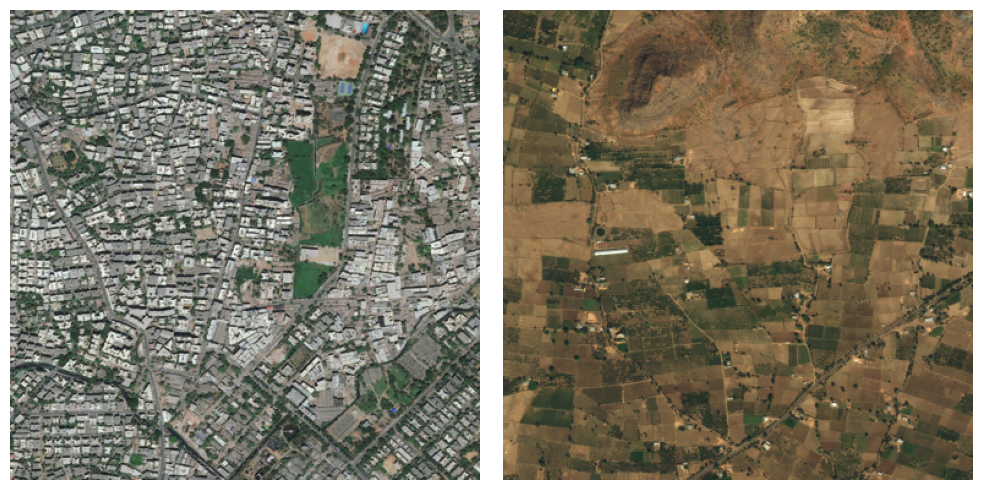

In [4]:
show_images(img1, img2)

In [6]:
def make_tensor(img_array):
    if not isinstance(img_array, np.ndarray):
        img_array = np.array(img_array)

    if np.max(img_array) > 1:
        img_array = img_array / 255
    
    return kornia.image_to_tensor(img_array).float().unsqueeze(0)

In [7]:
def make_image(tensor):
    return kornia.tensor_to_image(tensor.squeeze().byte())

In [8]:
def get_timestamp():
    return dt.datetime.strftime(dt.datetime.now(), format='%d_%m_%Y_%H%M%S')

In [9]:
tensor_img1 = make_tensor(img1)
tensor_img2 = make_tensor(img2)

# Radiation Image disturbances

In [10]:
arr_img1 = np.array(img1) / 255
arr_img2 = np.array(img2) / 255

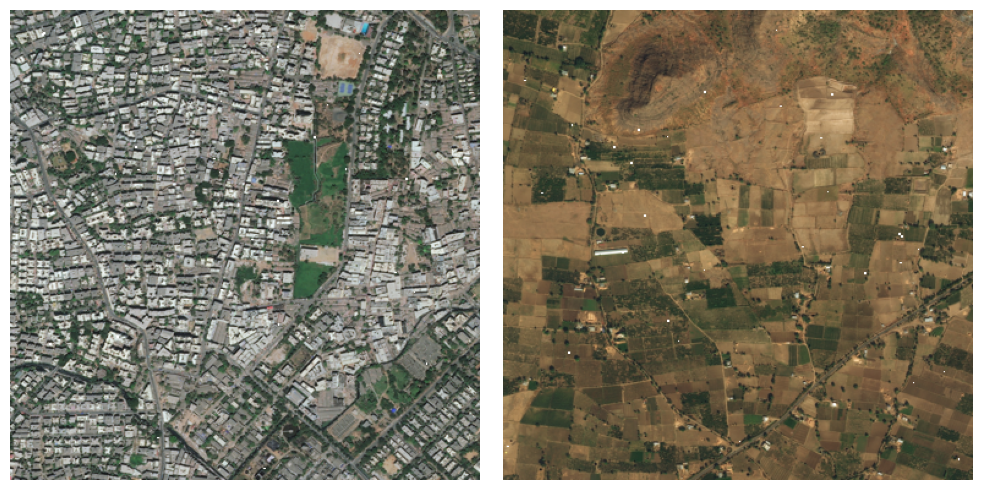

In [10]:
def hot_pixels(image, n_pixels=30):
    pixelated_image = np.copy(image)
    for _ in range(n_pixels):
        size_x = np.random.randint(1, 3)
        size_y = np.random.randint(1, 3)
        
        x = int(np.random.uniform(0, image.shape[0] - size_x))
        y = int(np.random.uniform(0, image.shape[1] - size_y))

        pixelated_image[x:x+size_x, y:y+size_y] = 1.
    return pixelated_image

hp_img1 = hot_pixels(arr_img1)
hp_img2 = hot_pixels(arr_img2)
show_images(hp_img1, hp_img2)

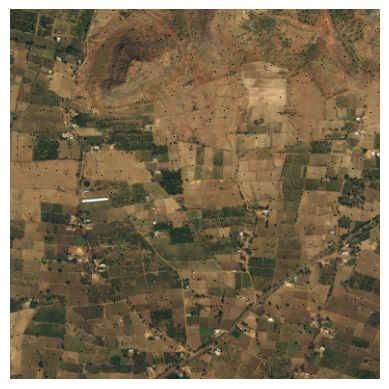

In [11]:
def dead_pixels(image):
    noise = np.zeros((image.shape[0], image.shape[1]), dtype=np.uint8)
    cv2.randu(noise, 0, 255)
    
    noise = cv2.threshold(noise, 253, 255, cv2.THRESH_BINARY_INV)[1]
    noise = noise / 255

    noise = noise[..., np.newaxis]
    image = image * noise

    return image
    
test = dead_pixels(arr_img2)
plt.imshow(test)
plt.axis('off')
plt.show();

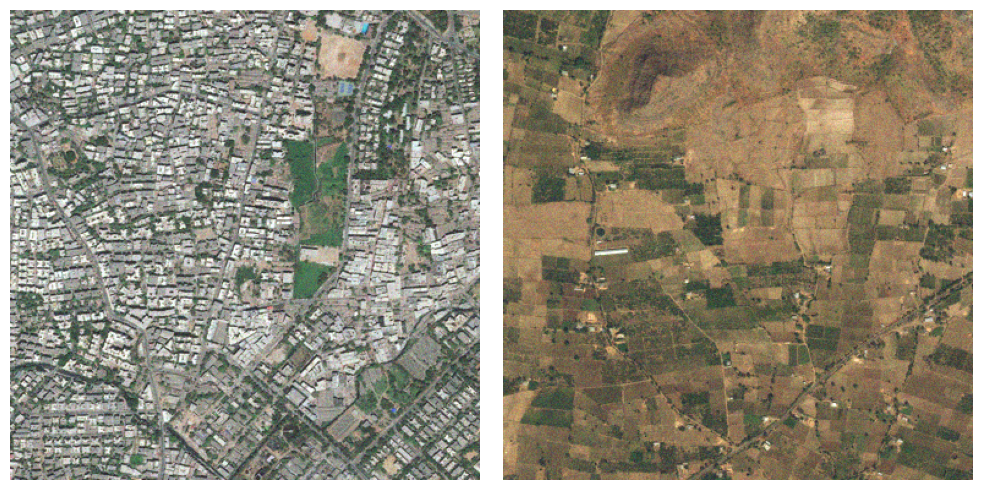

In [12]:
def dark_current(image):
    height, width = image.shape[0], image.shape[1]
    dark_current = np.random.uniform(0, 1, (height, width, 3)) * 0.15
    image = np.clip(image + dark_current, 0, 1)
    return image

dc_img1 = dark_current(arr_img1)
dc_img2 = dark_current(arr_img2)

show_images(dc_img1, dc_img2)


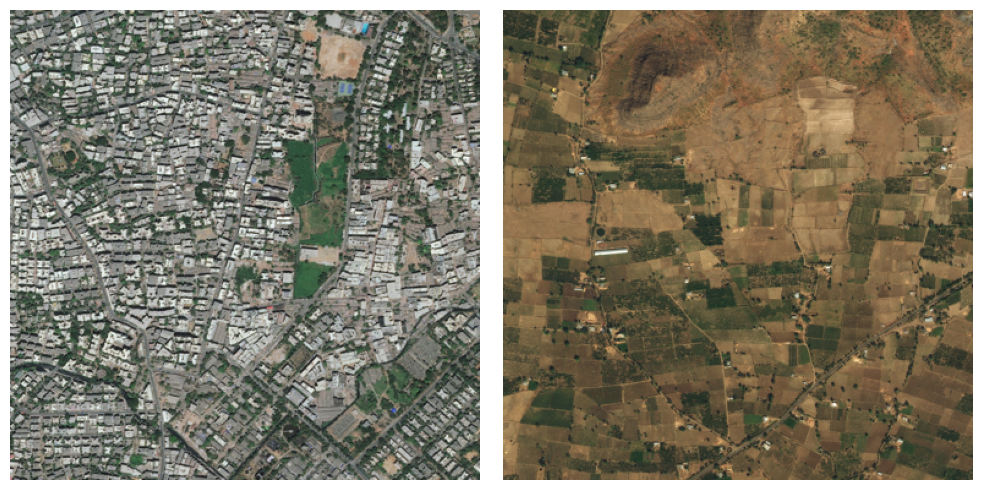

In [13]:
def pixel_saturation(image):
    noise = np.zeros((image.shape[0], image.shape[1]), dtype=np.uint8)
    cv2.randu(noise, 0, 255)
    individual_saturation = cv2.threshold(noise, 245, 10, cv2.THRESH_BINARY)[1]
    individual_saturation = individual_saturation / 255
    individual_saturation = individual_saturation[..., np.newaxis]
    noisy_image = image + individual_saturation
    noisy_image = np.clip(noisy_image, 0, 1)

    return noisy_image

ps_img1 = pixel_saturation(arr_img1)
ps_img2 = pixel_saturation(arr_img2)
show_images(ps_img1, ps_img2)

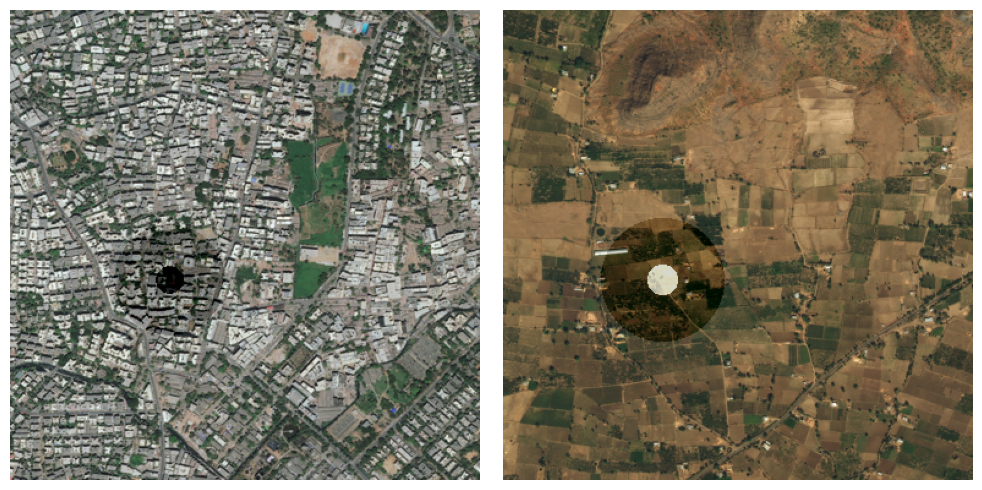

In [52]:
def add_particles(image, num_particles, darken=True):
    image_with_particles = np.copy(image)
    for _ in range(num_particles):
        particle_radius = np.random.uniform(10, 13)
        particle_center = np.random.rand(2) * (image.shape[0] - 2 * particle_radius) + particle_radius
        particle_center = np.array([220, 130])
        particle_brightness = np.random.uniform(0.9, 0.95)

        y, x = np.ogrid[:image.shape[0], :image.shape[1]]
        distances = np.sqrt((x - particle_center[1])**2 + (y - particle_center[0])**2)
        particle_mask = (distances <= particle_radius)

        if darken:
            image_with_particles[particle_mask, :] -= particle_brightness / 2
            image_with_particles[image_with_particles < 0] = 0
        else:
            image_with_particles[particle_mask, :] += particle_brightness / 1.5
            image_with_particles[image_with_particles > 1] = 1

        darkening_radius = particle_radius * 4
        particle_mask = (distances <= darkening_radius)

        image_with_particles[particle_mask, :] -= particle_brightness / 6
        image_with_particles[image_with_particles < 0] = 0

    return image_with_particles

p_img1 = add_particles(arr_img1, 1)
p_img2 = add_particles(arr_img2, 1, False)

# Display the original and modified images
show_images(p_img1, p_img2)

In [53]:
file_path = f'dirt_{get_timestamp()}.png'

image = Image.fromarray((p_img1 * 255).astype('uint8'))
image.save(file_path)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


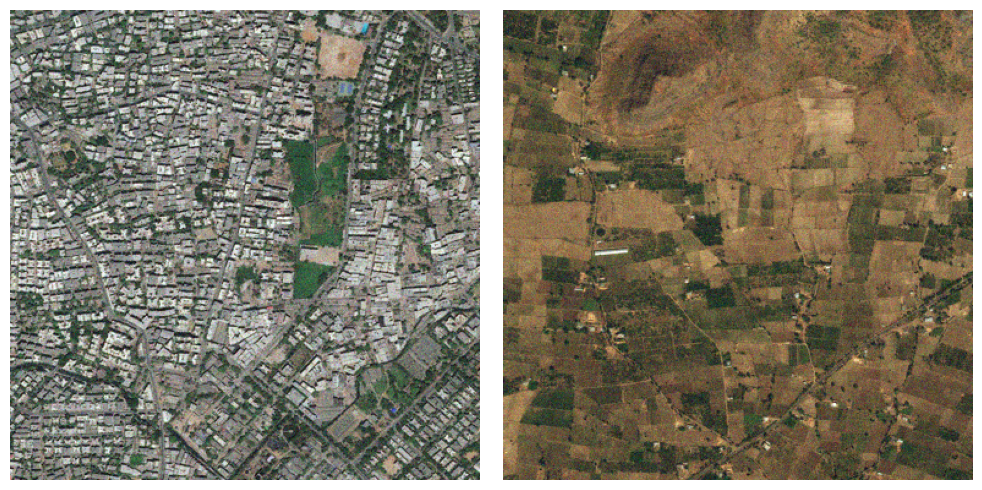

In [15]:
def gaussian_noise(image):
    tensor = make_tensor(image)
    aug = kornia.augmentation.RandomGaussianNoise(mean=0., std=0.05, p=1.)
    output_image = aug(tensor.clone())
    return output_image.squeeze().permute(1, 2, 0).cpu().numpy()

dc_img1 = gaussian_noise(arr_img1)
dc_img2 = gaussian_noise(arr_img2)

show_images(dc_img1, dc_img2)


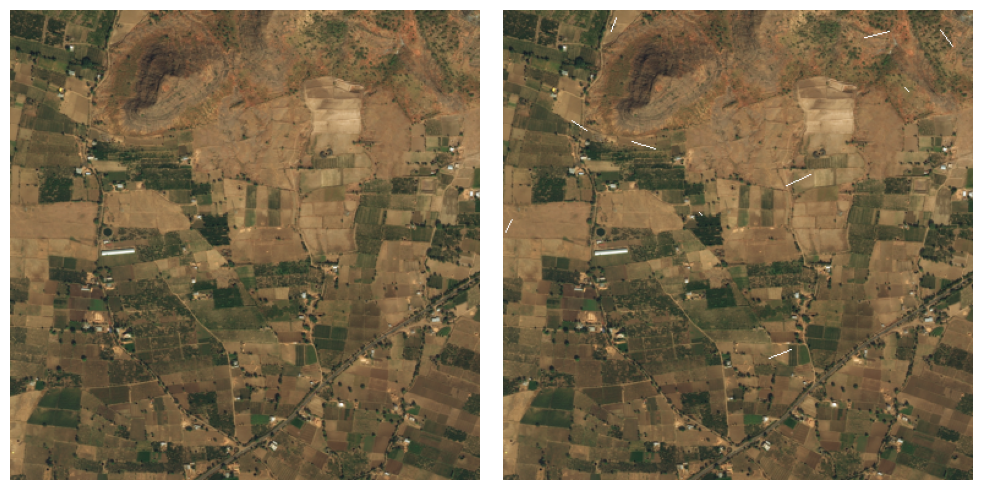

In [19]:
def add_streaks_to_image(original_image, num_streaks, streak_length=30):

    # Create a copy of the original image to avoid modifying it
    image_with_streaks = np.copy(original_image)

    for _ in range(num_streaks):
        # Randomly generate streak properties
        streak_angle = np.random.uniform(0, 2*np.pi)  # Angle in radians
        streak_intensity = 1  # Intensity of the streak
        length = streak_length * np.random.rand()
        
        # Calculate the endpoints of the streak
        x1 = np.random.randint(0, image_with_streaks.shape[0])
        y1 = np.random.randint(0, image_with_streaks.shape[1])
        x2 = int(x1 + length * np.cos(streak_angle))
        y2 = int(y1 + length * np.sin(streak_angle))

        # Draw the streak on the image
        cv2.line(image_with_streaks, (x1, y1), (x2, y2), (streak_intensity, streak_intensity, streak_intensity), 1)


    # Ensure pixel values are within [0, 1]
    image_with_streaks[image_with_streaks < 0] = 0
    image_with_streaks[image_with_streaks > 1] = 1

    return image_with_streaks

num_streaks = 10
image_with_streaks = add_streaks_to_image(arr_img2, num_streaks)

show_images(arr_img2, image_with_streaks)

# Bringing all together

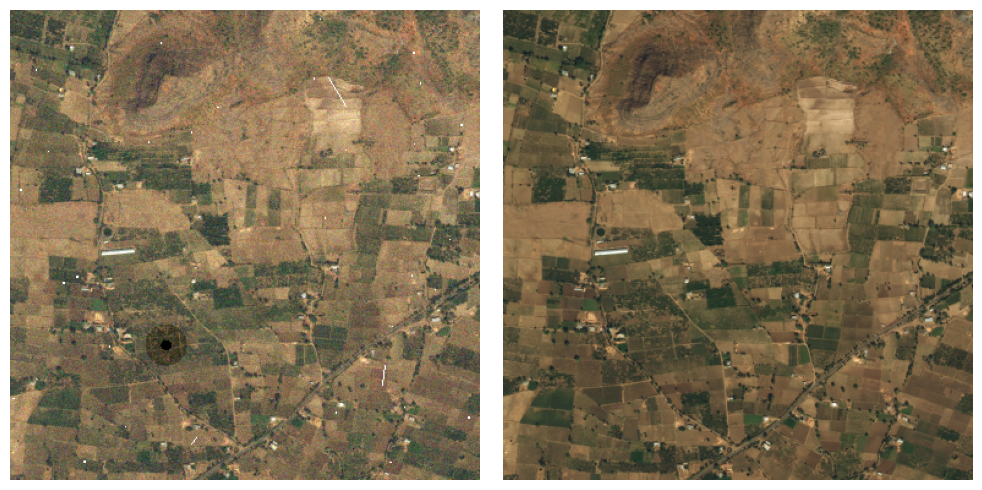

In [20]:
i = arr_img2
i = hot_pixels(i)
i = dark_current(i)
i = pixel_saturation(i)
i = add_streaks(i, 3)
i = add_particles(i, 1)

show_images(i, arr_img2)

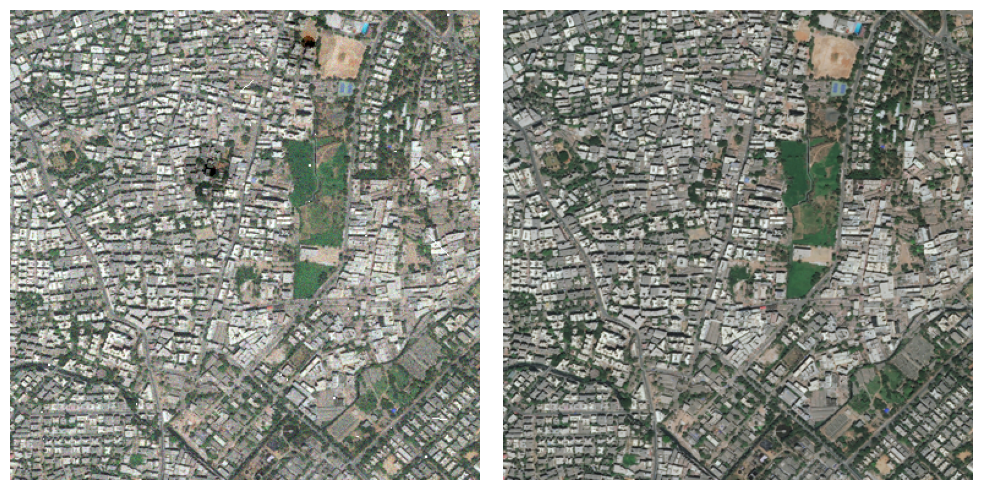

In [21]:
i = arr_img1
i = hot_pixels(i)
i = dark_current(i)
i 
i = pixel_saturation(i)
i = add_streaks(i, 3)
i = add_particles(i, 2)

show_images(i, arr_img1)

In [1582]:
file_path = f'radiation_{get_timestamp()}.png'

image = Image.fromarray((i * 255).astype('uint8'))
image.save(file_path)

# Other disturbances to the image

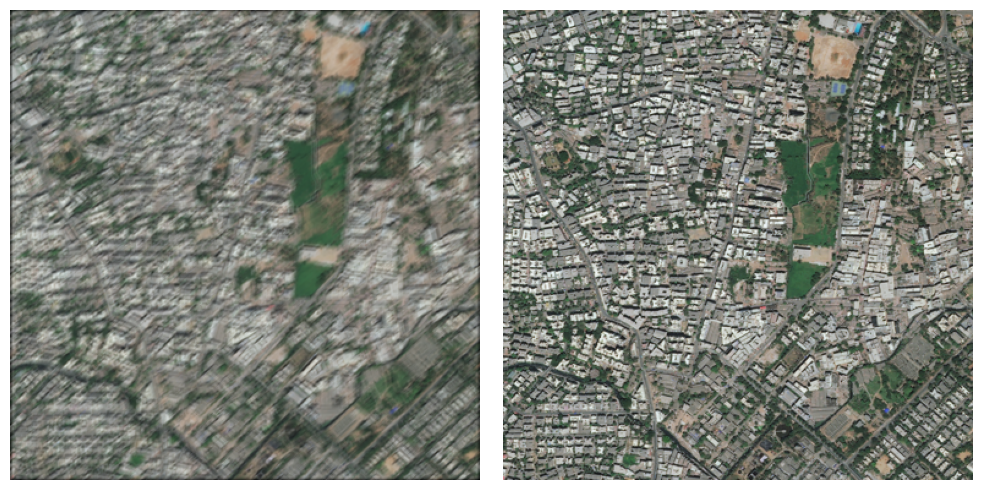

In [22]:
aug = kornia.filters.MotionBlur(7, 35., 0.1)
output_image = aug(tensor_img1.clone())

augmented_image = output_image.squeeze().permute(1, 2, 0).cpu().numpy()
show_images(augmented_image, img1)

In [992]:
file_path = f'motion_blur_{get_timestamp()}.png'

image = Image.fromarray((augmented_image * 255).astype('uint8'))
image.save(file_path)

## Random Plasma Shadow

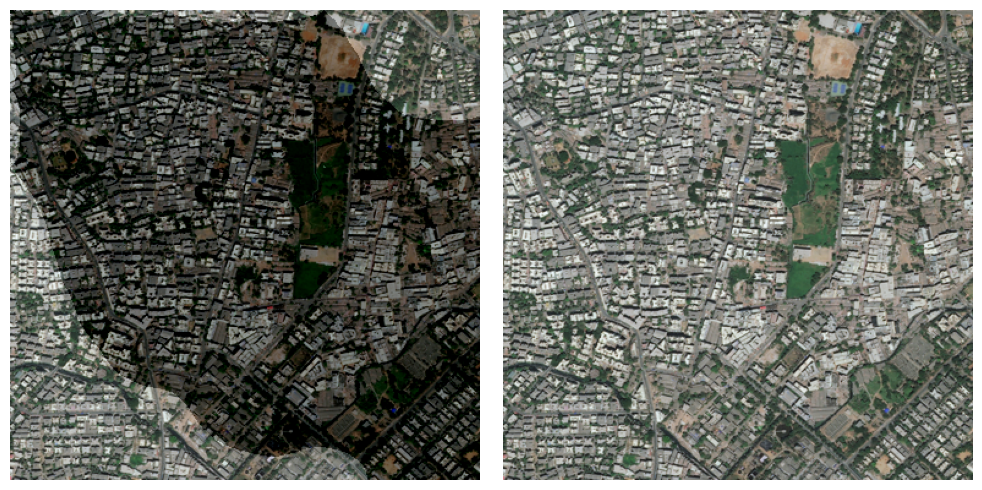

In [40]:
aug = kornia.augmentation.RandomPlasmaShadow(roughness=(0.23, 0.7), p=1.)
output_image = aug(tensor_img1.clone())

augmented_image = output_image.squeeze().permute(1, 2, 0).cpu().numpy()
show_images(augmented_image, img1)

In [1173]:
file_path = f'random_plasma_shadow_{get_timestamp()}.png'

image = Image.fromarray((augmented_image * 255).astype('uint8'))
image.save(file_path)

## Random Plasma Contrast

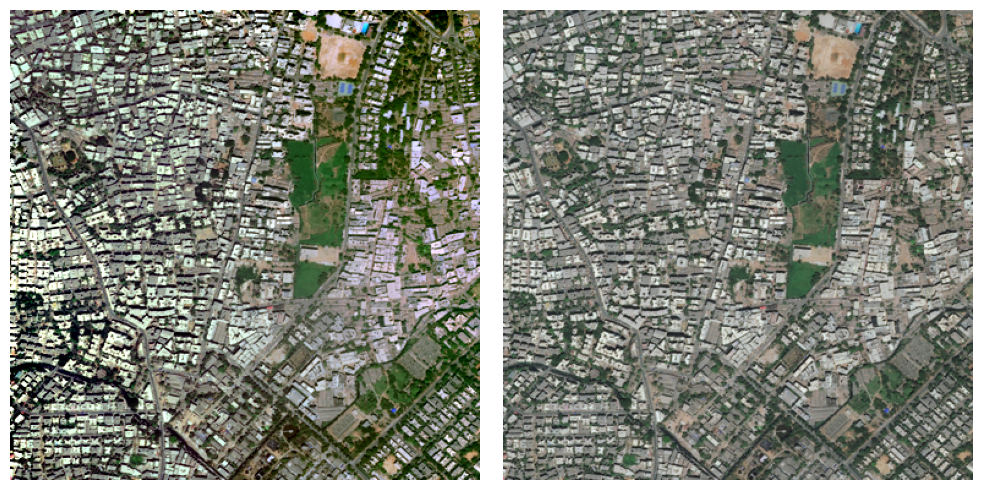

In [41]:
aug = kornia.augmentation.RandomPlasmaContrast(roughness=(0.1, 0.2), p=1.)
output_image = aug(tensor_img1.clone())

augmented_image = output_image.squeeze().permute(1, 2, 0).cpu().numpy()

show_images(augmented_image, img1)

In [1175]:
file_path = f'random_plasma_contrast_{get_timestamp()}.png'

image = Image.fromarray((augmented_image * 255).astype('uint8'))
image.save(file_path)

## Random Color Jiggle

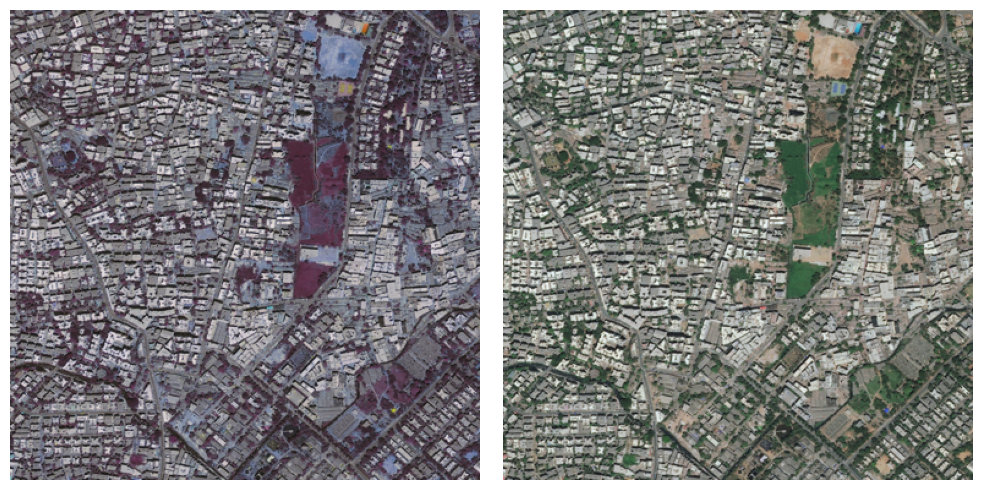

In [51]:
aug = kornia.augmentation.ColorJiggle(0.1, 0.1, 0.1, 0.5, p=1.)
output_image = aug(tensor_img1.clone())

augmented_image = output_image.squeeze().permute(1, 2, 0).cpu().numpy()
show_images(augmented_image, img1)

In [1180]:
file_path = f'random_color_jiggle_{get_timestamp()}.png'

image = Image.fromarray((augmented_image * 255).astype('uint8'))
image.save(file_path)

## Random Brightness

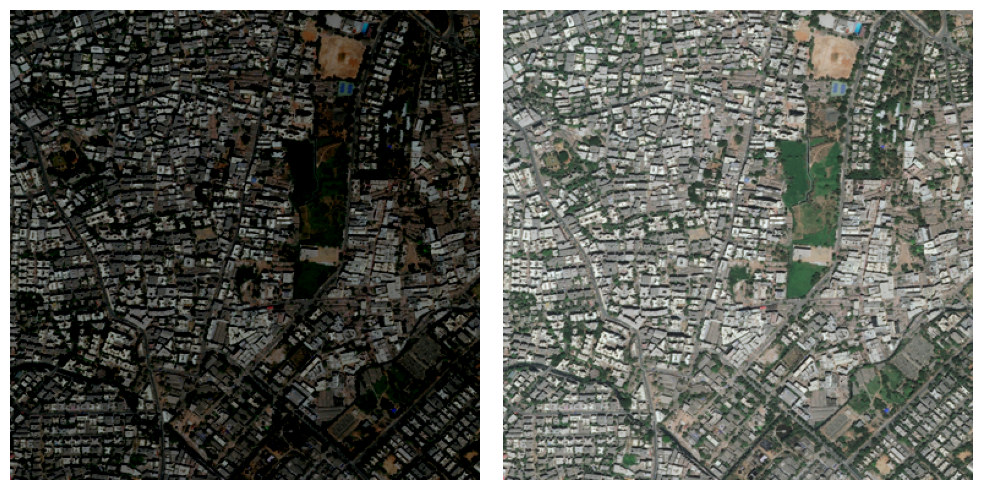

In [52]:
aug = kornia.augmentation.RandomBrightness(brightness=(.5, .7), p=1.)
output_image = aug(tensor_img1.clone())

augmented_image = output_image.squeeze().permute(1, 2, 0).cpu().numpy()

show_images(augmented_image, img1)

In [1187]:
file_path = f'random_brightness_dark_{get_timestamp()}.png'

image = Image.fromarray((augmented_image * 255).astype('uint8'))
image.save(file_path)

## Random Contrast

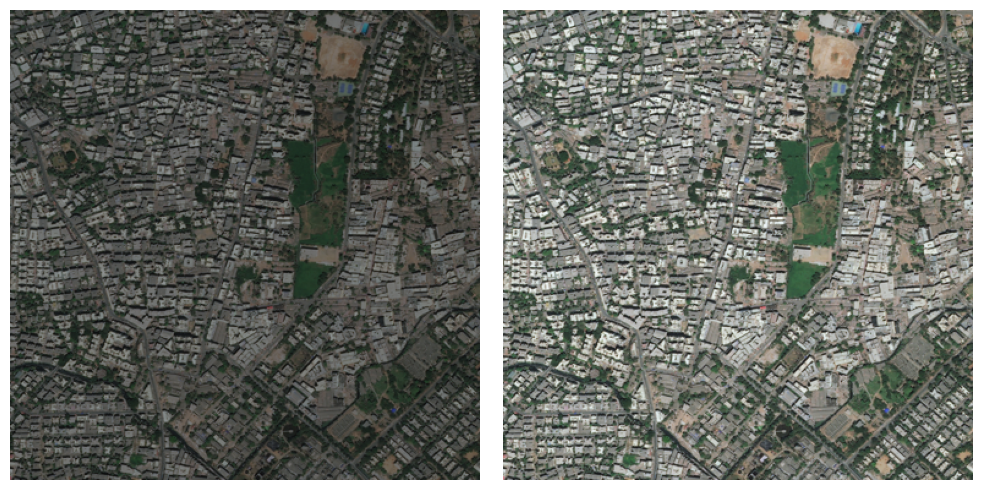

In [53]:
aug = kornia.augmentation.RandomContrast(contrast=(.5, .6), p=1.)

output_image = aug(tensor_img1.clone())

augmented_image = output_image.squeeze().permute(1, 2, 0).cpu().numpy()

show_images(augmented_image, img1)

In [1191]:
file_path = f'random_contrast_low_{get_timestamp()}.png'

image = Image.fromarray((augmented_image * 255).astype('uint8'))
image.save(file_path)

## Random Gamma

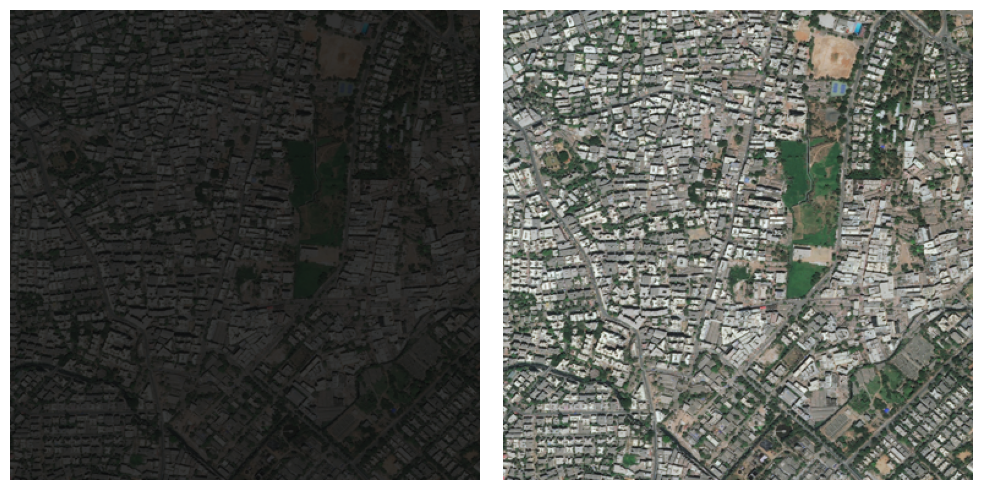

In [54]:
aug = kornia.augmentation.RandomGamma((.5, 1.), (0.2, 0.3), p=1.)
output_image = aug(tensor_img1.clone())

augmented_image = output_image.squeeze().permute(1, 2, 0).cpu().numpy()

show_images(augmented_image, img1)

In [1200]:
file_path = f'random_gamma_low_gamma_{get_timestamp()}.png'

image = Image.fromarray((augmented_image * 255).astype('uint8'))
image.save(file_path)

## Random Gaussian Blur

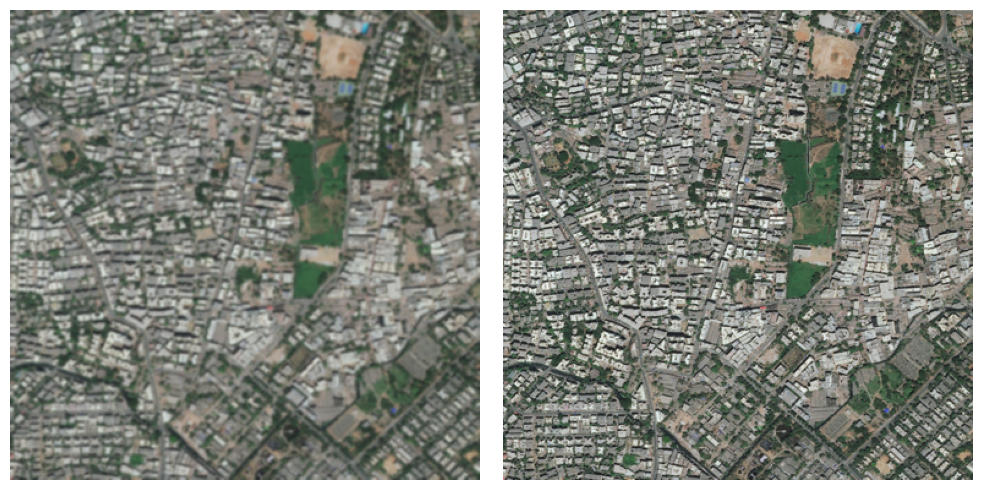

In [55]:
aug = kornia.augmentation.RandomGaussianBlur((7, 7), (0.5, 2.), p=1.)
output_image = aug(tensor_img1.clone())

augmented_image = output_image.squeeze().permute(1, 2, 0).cpu().numpy()

show_images(augmented_image, img1)

In [56]:
file_path = f'random_gaussian_blur_{get_timestamp()}.png'

image = Image.fromarray((augmented_image * 255).astype('uint8'))
image.save(file_path)

## Random Gaussian Noise

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


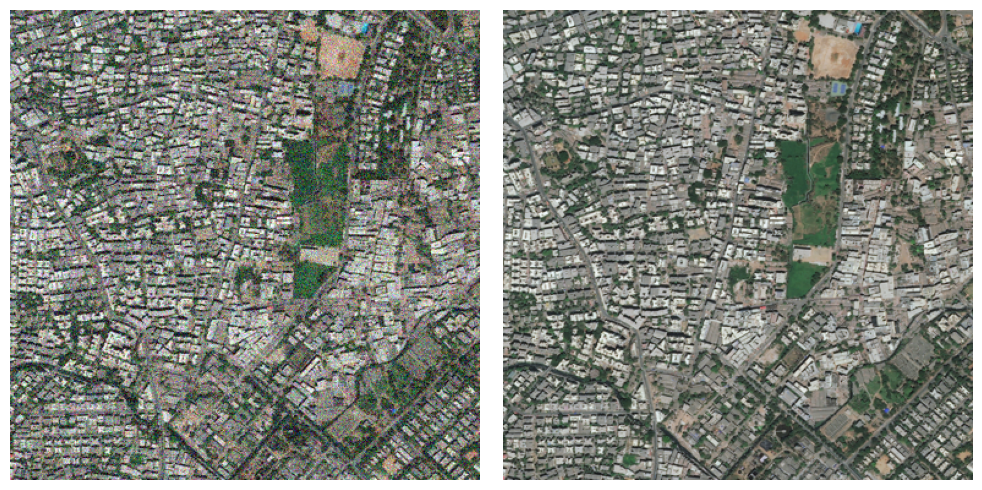

In [57]:
aug = kornia.augmentation.RandomGaussianNoise(mean=0., std=0.1, p=1.)
output_image = aug(tensor_img1.clone())

augmented_image = output_image.squeeze().permute(1, 2, 0).cpu().numpy()

show_images(augmented_image, img1)

In [58]:
file_path = f'random_gaussian_noise_{get_timestamp()}.png'

image = Image.fromarray((augmented_image * 255).astype('uint8'))
image.save(file_path)

## Random Saturation

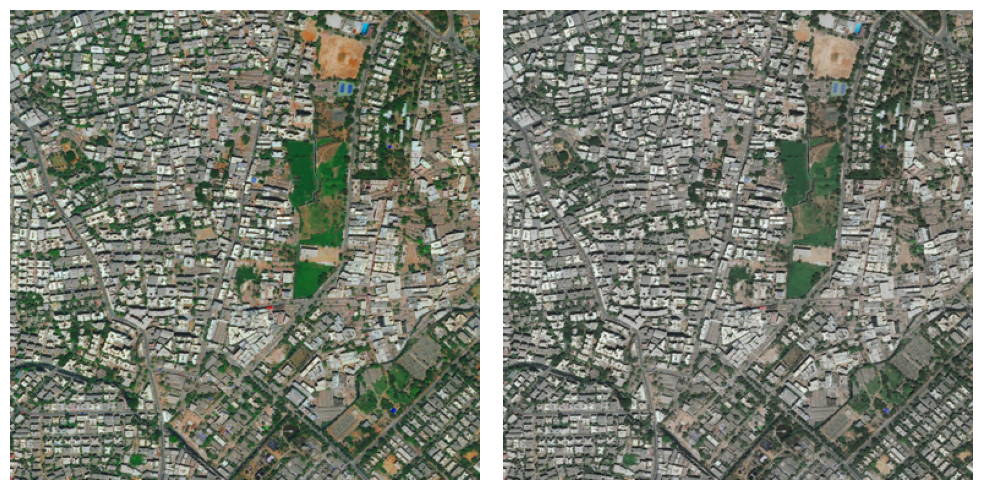

In [59]:
aug = kornia.augmentation.RandomSaturation(saturation=(1.8, 2.), p=1.)
output_image = aug(tensor_img1.clone())

augmented_image = output_image.squeeze().permute(1, 2, 0).cpu().numpy()

show_images(augmented_image, img1)

In [60]:
file_path = f'random_saturation_{get_timestamp()}.png'

image = Image.fromarray((augmented_image * 255).astype('uint8'))
image.save(file_path)

## Random Erasing

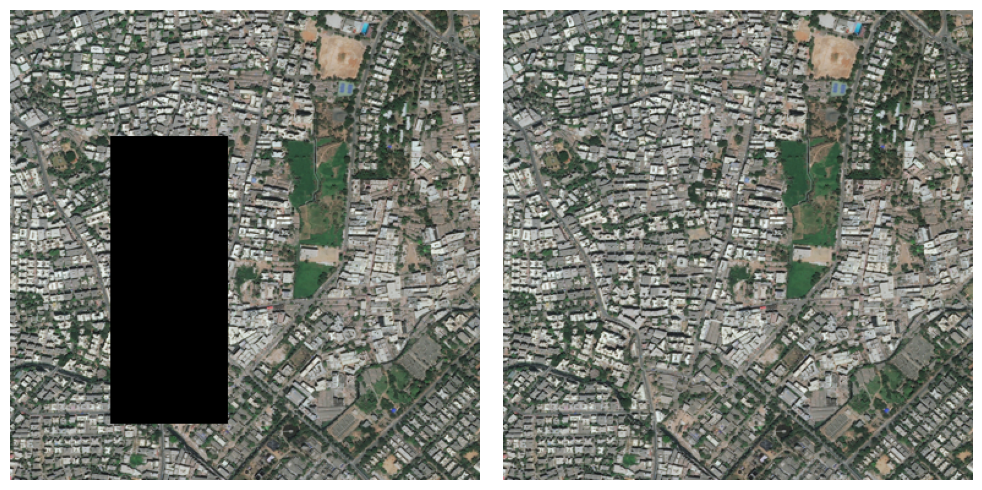

In [62]:
aug = kornia.augmentation.RandomErasing(scale=(0.02, 0.33), ratio=(.3, 3.1), p=1.)
output_image = aug(tensor_img1.clone())

augmented_image = output_image.squeeze().permute(1, 2, 0).cpu().numpy()

show_images(augmented_image, img1)

In [63]:
file_path = f'random_erasing_{get_timestamp()}.png'

image = Image.fromarray((augmented_image * 255).astype('uint8'))
image.save(file_path)

## Random Elastic Transform

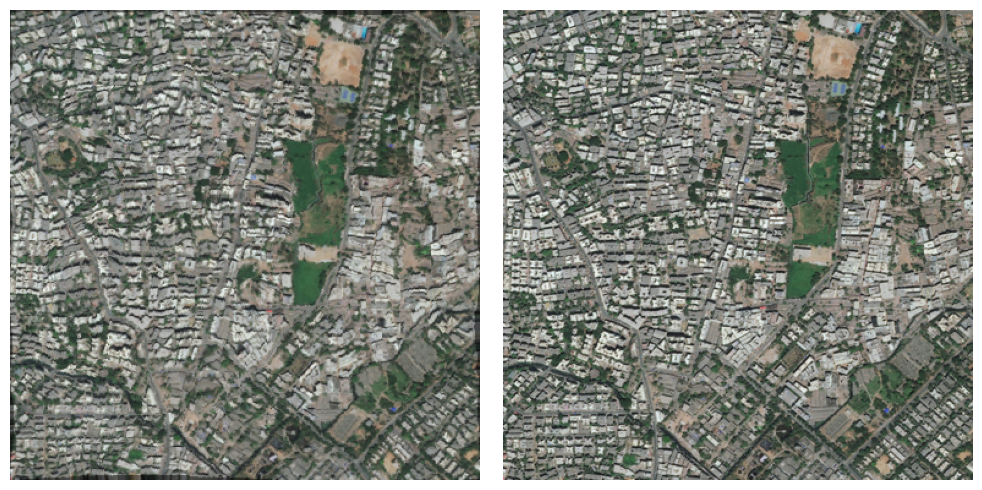

In [64]:
aug = kornia.augmentation.RandomElasticTransform(kernel_size=(53, 53), sigma=(32.0, 32.0), p=1.)
output_image = aug(tensor_img1.clone())

augmented_image = output_image.squeeze().permute(1, 2, 0).cpu().numpy()

show_images(augmented_image, img1)

In [65]:
file_path = f'random_elastic_transform_{get_timestamp()}.png'

image = Image.fromarray((augmented_image * 255).astype('uint8'))
image.save(file_path)

## Bright Spots in the image

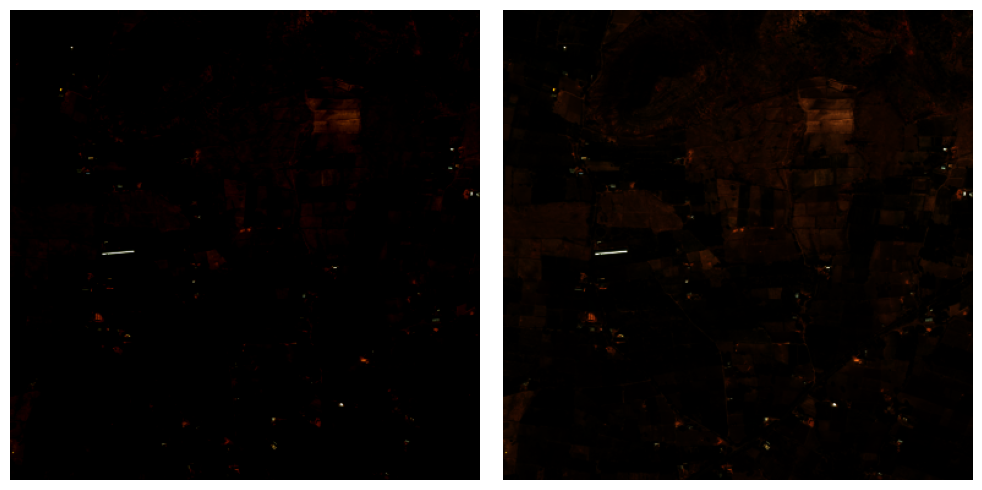

In [66]:
input_image = tensor_img2 ** 5

# Use the Kornia.enhance.AdjustContrast too improve the image
contrast_aug = kornia.enhance.AdjustContrast(0.9)
brightnes_aug = kornia.enhance.AdjustBrightness(-0.05)
output_image = contrast_aug(input_image.clone())
output_image = brightnes_aug(output_image)

augmented_image = output_image.squeeze().permute(1, 2, 0).cpu().numpy()
baseline_image = input_image.squeeze().permute(1, 2, 0).cpu().numpy()

show_images(augmented_image, baseline_image)

In [67]:
file_path = f'bright_spot{get_timestamp()}.png'

image = Image.fromarray((augmented_image * 255).astype('uint8'))
image.save(file_path)